# EDA

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

#ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#load prepared data
filename = 'Wroclaw-Korzeniowskiego_meteo_2005_2017_prepared.csv'
data = pd.read_csv(filename)

## Data overview

In [ ]:
data.head()

,Unnamed: 0,Year,Month,Day,Hour,Air pressure,Air temperature,RAD radiation,Precipitation,Realtive humidity,UVB radiation,Wind direction,Wind speed,CO,NO2,NOx,O3,PM2.5,PM10,SO2,C6H6,Hg(TGM)
0,0,2005,1,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,21.0,27.0,5.0,20.0,NaN,NaN,NaN,NaN
1,1,2005,1,1,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.400,19.0,23.0,5.0,22.0,NaN,NaN,NaN,NaN
2,2,2005,1,1,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,19.0,23.0,6.0,20.0,NaN,NaN,NaN,NaN
3,3,2005,1,1,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.455,23.0,29.0,5.0,16.0,NaN,NaN,NaN,NaN
4,4,2005,1,1,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.425,23.0,29.0,3.0,18.0,NaN,NaN,NaN,NaN


In [ ]:
data.shape

(113952, 22)

In [ ]:
data.isna().sum().sort_values(ascending=False)

Hg(TGM)              113952
SO2                   88907
PM10                  76622
Air temperature       65369
Precipitation         65225
C6H6                  55431
Wind direction        29177
Wind speed            27596
CO                    27136
Realtive humidity     22824
UVB radiation         22824
O3                    18075
RAD radiation         14435
NOx                   14083
NO2                   14081
Air pressure          11295
PM2.5                  8931
Hour                      0
Day                       0
Month                     0
Year                      0
Unnamed: 0                0
dtype: int64

Conclusions:
*   In following dataset there is a lot of missing values. 
*   Some of columns like HG(TGM) and Unnamed:0 should be discarded.


In [ ]:
data.drop(['Unnamed: 0','Hg(TGM)'],axis=1, inplace=True)

In [ ]:
data_columns = data.columns

In [ ]:
data = data.rename(columns={"Month ": "Month"})

## Missing values through the years

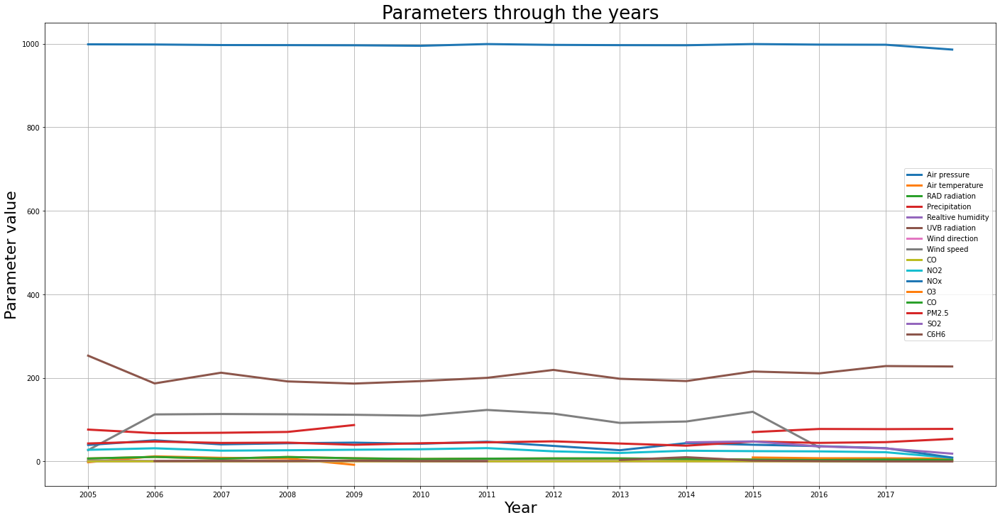

In [ ]:
fig,ax = plt.subplots(figsize = (24,12))

air_press = sns.lineplot(data['Year'],data['Air pressure'],label = 'Air pressure',linewidth=3)
air_temp = sns.lineplot(data['Year'],data['Air temperature'],label = 'Air temperature',linewidth=3)
rad_rad = sns.lineplot(data['Year'],data['RAD radiation'],label = 'RAD radiation',linewidth=3)
precipitation = sns.lineplot(data['Year'],data['Precipitation'],label = 'Precipitation',linewidth=3)
relative_hum = sns.lineplot(data['Year'],data['Realtive humidity'],label = 'Realtive humidity',linewidth=3)
uvb_rad = sns.lineplot(data['Year'],data['UVB radiation'],label = 'UVB radiation',linewidth=3)
wind_dir = sns.lineplot(data['Year'],data['Wind direction'],label = 'Wind direction',linewidth=3)
wind_speed = sns.lineplot(data['Year'],data['Wind speed'],label = 'Wind speed',linewidth=3)
co = sns.lineplot(data['Year'],data['CO'],label = 'CO',linewidth=3)
no2 = sns.lineplot(data['Year'],data['NO2'],label = 'NO2',linewidth=3)
nox = sns.lineplot(data['Year'],data['NOx'],label = 'NOx',linewidth=3)
o3 = sns.lineplot(data['Year'],data['O3'],label = 'O3',linewidth=3)
pm25 = sns.lineplot(data['Year'],data['O3'],label = 'CO',linewidth=3)
pm10 = sns.lineplot(data['Year'],data['PM2.5'],label = 'PM2.5',linewidth=3)
so2 = sns.lineplot(data['Year'],data['SO2'],label = 'SO2',linewidth=3)
c6h6 = sns.lineplot(data['Year'],data['C6H6'],label = 'C6H6',linewidth=3)

ax.set_ylabel('Parameter value', fontsize=22)
ax.set_xlabel('Year', fontsize=22)
plt.title('Parameters through the years', fontsize=26)
plt.xticks(range(data['Year'].min(),data['Year'].max()))

plt.tight_layout
plt.grid()
plt.show()

In [ ]:
values_dict = {}
for i in range(2005,2018):
  values = data.loc[data['Year'] == i].isna().sum().values
  values_dict.update( {i : values})

In [ ]:
missing_data = pd.DataFrame(values_dict)
missing_data = missing_data.T
missing_data.columns = data_columns
missing_data['Total missing']=missing_data.sum(axis=1)
missing_data = missing_data.sort_values(by='Total missing')
missing_data.style.background_gradient()

,Year,Month,Day,Hour,Air pressure,Air temperature,RAD radiation,Precipitation,Realtive humidity,UVB radiation,Wind direction,Wind speed,CO,NO2,NOx,O3,PM2.5,PM10,SO2,C6H6,Total missing
2015,0,0,0,0,27,783,55,783,24,24,24,74,220,473,473,205,52,585,8759,1961,14522
2016,0,0,0,0,8,7,25,7,7,7,7526,7457,83,73,73,102,87,443,223,453,16581
2017,0,0,0,0,28,28,2774,28,28,28,8760,8760,100,99,99,98,81,332,371,3002,24616
2008,0,0,0,0,10,8,8,8,2367,2367,9,8,1217,1012,1013,2611,166,8784,8784,451,28823
2009,0,0,0,0,12,7547,12,7547,10,10,8,8,1208,1001,1001,1181,416,4232,8760,1655,34608
2007,0,0,0,0,135,1093,128,949,6101,6101,5,131,1039,470,470,2563,358,8760,8760,2971,40034
2010,0,0,0,0,4,8760,4,8760,5,5,3,3,3854,2457,2457,2144,693,904,8760,3434,42247
2006,0,0,0,0,706,3786,766,3786,3882,3882,514,757,1073,580,580,779,355,8760,8760,3849,42815
2014,0,0,0,0,1027,8760,1288,8760,1026,1026,1026,1026,1533,138,136,691,1196,8760,667,8759,45819
2012,0,0,0,0,38,8784,38,8784,38,38,1038,37,1845,968,968,3058,1093,8784,8784,8784,53079


Conclusions
*   Missing values for some years make it necessary to reject them from further analysis.
*   The best years that can be used for further analysis is 2015:14522 missing values and 2016:16581 missing values
*   However, the choice of year depends on the data we need. For example in case of 2015 there are 8759 missing values for SO2 but in case of 2016 there instead of missing values in SO2 we've got a lot of missing values in Wind direction and speed. 



## Three best years in field of missing values

In [ ]:
data_2015 = data[data['Year']==2015]
data_2017 = data[data['Year']==2017]

In [ ]:
data_2015.reset_index(drop=True, inplace=True)
data_2017.reset_index(drop=True, inplace=True)

In [ ]:
data_2015.drop(['Wind direction','Wind speed'], axis=1, inplace=True)
data_2017.drop(['Wind direction','Wind speed'], axis=1, inplace=True)

In [ ]:
data_2015['SO2'] = data_2016['SO2'][0:8760].values

In [ ]:
index3 = data_2015['Air temperature'].index[data_2015['Air temperature'].apply(np.isnan)]
index4 = data_2015['Precipitation'].index[data_2015['Precipitation'].apply(np.isnan)]

In [ ]:
data_2015['C6H6'].loc[index] = data_2016['C6H6'].loc[index].values
data_2017['C6H6'].loc[index1] = data_2016['C6H6'].loc[index1].values

In [ ]:
data_2017['RAD radiation'].loc[index2] = data_2016['RAD radiation'].loc[index2].values

In [ ]:
#Linear backward propagation of last non-NaN value
data_2015 = data_2015.interpolate()
data_2017 = data_2017.interpolate()

In [ ]:
data_2015['Air temperature'].loc[index3] = data_2016['Air temperature'].loc[index3].values
data_2015['Precipitation'].loc[index4] = data_2016['Precipitation'].loc[index4].values

In [ ]:
data_2015.reset_index(drop=True, inplace=True)
data_2017.reset_index(drop=True, inplace=True)

In [ ]:
data_2015

,Year,Month,Day,Hour,Air pressure,Air temperature,RAD radiation,Precipitation,Realtive humidity,UVB radiation,CO,NO2,NOx,O3,PM2.5,PM10,SO2,C6H6
0,2015,1,1,0,1012.0,NaN,0.0,NaN,1.6,278.0,0.575,18.0,20.0,7.0,19.0,NaN,35.778146,5.01000
1,2015,1,1,1,1011.0,NaN,0.0,NaN,1.5,279.0,0.581,20.0,25.0,7.0,13.0,50.0,244.272000,5.25388
2,2015,1,1,2,1011.0,NaN,0.0,NaN,1.4,286.0,0.678,20.0,25.0,6.0,11.0,34.0,102.633000,4.74133
3,2015,1,1,3,1012.0,NaN,0.2,NaN,1.5,292.0,0.686,21.0,24.0,6.0,9.0,29.0,77.725900,4.66580
4,2015,1,1,4,1012.0,NaN,0.0,NaN,1.7,299.0,0.653,22.0,25.0,6.0,10.0,21.0,69.562100,4.77038
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,2015,12,31,19,1008.2,-3.9,0.0,47.5,1.4,226.5,0.375,24.0,28.0,6.0,40.0,27.0,93.797600,3.68000
8756,2015,12,31,20,1008.0,-4.3,0.0,49.6,1.1,234.4,0.376,24.0,27.0,6.0,39.0,24.0,99.660300,3.37000
8757,2015,12,31,21,1008.0,-4.9,0.0,52.3,0.8,195.6,0.504,38.0,43.0,8.0,23.0,39.0,99.730600,3.99000
8758,2015,12,31,22,1008.1,-5.5,0.0,55.7,0.6,169.1,0.742,51.0,60.0,14.0,10.0,52.0,94.896400,4.66000


In [ ]:
data_2017

,Year,Month,Day,Hour,Air pressure,Air temperature,RAD radiation,Precipitation,Realtive humidity,UVB radiation,CO,NO2,NOx,O3,PM2.5,PM10,SO2,C6H6
0,2017,1,1,0,1006.1,-3.8,0.0,60.3,1.1,256.9,0.642708,34.27210,39.54970,11.13720,13.9411,69.19820,75.9017,0.84292
1,2017,1,1,1,1005.7,-3.7,0.0,58.7,1.3,257.8,0.583785,31.88530,36.20530,14.98440,15.2567,100.62300,105.4330,1.19198
2,2017,1,1,2,1005.4,-3.7,0.0,57.6,1.1,268.4,0.590977,34.74580,39.40260,14.70370,13.9686,94.21910,96.0673,0.80662
3,2017,1,1,3,1004.9,-3.9,0.0,59.8,1.1,268.9,0.519569,32.60120,35.83880,11.22250,14.5080,59.50000,59.4541,0.85666
4,2017,1,1,4,1004.2,-4.3,0.0,61.0,0.8,264.4,0.495704,34.60610,40.25130,9.87249,13.1370,50.77440,51.6827,0.52458
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,2017,12,31,19,987.3,7.2,0.0,79.2,2.2,255.2,0.261702,13.07010,14.59970,5.07044,50.3412,12.50000,12.4794,0.10118
8756,2017,12,31,20,987.4,7.6,0.0,78.9,1.4,242.9,0.276685,13.74520,15.52860,4.16316,48.5977,9.20527,12.9222,0.05296
8757,2017,12,31,21,987.3,7.5,0.0,78.4,1.8,237.5,0.275513,12.86670,14.56780,4.20014,49.8737,12.14580,13.7008,0.05363
8758,2017,12,31,22,986.9,7.4,0.0,78.4,1.7,238.2,0.259061,8.61409,9.90682,3.42904,52.7504,13.60000,13.5731,0.04195


In [ ]:
data_2015.isna().sum()

Year                 0
Month                0
Day                  0
Hour                 0
Air pressure         0
Air temperature      0
RAD radiation        0
Precipitation        0
Realtive humidity    0
UVB radiation        0
CO                   0
NO2                  0
NOx                  0
O3                   0
PM2.5                0
PM10                 1
SO2                  0
C6H6                 0
dtype: int64

In [ ]:
data_2017.isna().sum()

Year                 0
Month                0
Day                  0
Hour                 0
Air pressure         0
Air temperature      0
RAD radiation        0
Precipitation        0
Realtive humidity    0
UVB radiation        0
CO                   0
NO2                  0
NOx                  0
O3                   0
PM2.5                0
PM10                 0
SO2                  0
C6H6                 0
dtype: int64

In [ ]:
data_2016.isna().sum()

Month                0
Day                  0
Hour                 0
Air pressure         0
Air temperature      0
RAD radiation        0
Precipitation        0
Realtive humidity    0
UVB radiation        0
CO                   0
NO2                  0
NOx                  0
O3                   0
PM2.5                0
PM10                 0
SO2                  0
C6H6                 0
timestamp            0
dtype: int64

In [ ]:
data_2015.columns == data_2017.columns

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True])

In [ ]:
data_2015.columns == data_2016.columns

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False])

In [ ]:
data_2016.columns

Index(['Month', 'Day', 'Hour', 'Air pressure', 'Air temperature',
       'RAD radiation', 'Precipitation', 'Realtive humidity', 'UVB radiation',
       'CO', 'NO2', 'NOx', 'O3', 'PM2.5', 'PM10', 'SO2', 'C6H6', 'Year'],
      dtype='object')

In [ ]:
data_2015.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Air pressure', 'Air temperature',
       'RAD radiation', 'Precipitation', 'Realtive humidity', 'UVB radiation',
       'CO', 'NO2', 'NOx', 'O3', 'PM2.5', 'PM10', 'SO2', 'C6H6'],
      dtype='object')

In [ ]:
data_2017.columns

Index(['Year', 'Month', 'Day', 'Hour', 'Air pressure', 'Air temperature',
       'RAD radiation', 'Precipitation', 'Realtive humidity', 'UVB radiation',
       'CO', 'NO2', 'NOx', 'O3', 'PM2.5', 'PM10', 'SO2', 'C6H6'],
      dtype='object')

In [ ]:
frames = [data_2015, data_2016, data_2017]

In [ ]:
last_three_data = pd.concat(frames)

In [ ]:
last_three_data= last_three_data.interpolate()

In [ ]:
last_three_data.to_csv('final_data.csv', sep=',')

In [ ]:
#Reading filled data. 
data_2016 = pd.read_csv('data_2016.csv', sep=';')

In [ ]:
data_2016.columns

Index(['Unnamed: 0', 'Month', 'Day', 'Hour', 'Air pressure', 'Air temperature',
       'RAD radiation', 'Precipitation', 'Realtive humidity', 'UVB radiation',
       'CO', 'NO2', 'NOx', 'O3', 'PM2.5', 'PM10', 'SO2', 'C6H6', 'timestamp'],
      dtype='object')

In [ ]:
data_2016.drop(['Unnamed: 0', 'timestamp'], axis=1, inplace=True)

In [ ]:
data_2016['Year'] = 2016

In [ ]:
data_2016

,Month,Day,Hour,Air pressure,Air temperature,RAD radiation,Precipitation,Realtive humidity,UVB radiation,CO,NO2,NOx,O3,PM2.5,PM10,SO2,C6H6,timestamp,Year
0,1,1,0,1008.0,-6.6,0.0,62.8,0.3,137.9,0.799000,41.0000,50.0000,11.0000,10.00000,92.0000,NaN,5.01000,0,2016
1,1,1,1,1007.8,-7.4,0.0,69.6,0.5,98.7,0.843089,38.9970,67.3052,14.3284,4.52378,233.7600,244.2720,5.25388,1,2016
2,1,1,2,1007.7,-7.1,0.0,72.3,0.6,156.5,0.637449,33.4732,41.8251,12.6397,10.19110,81.7649,102.6330,4.74133,2,2016
3,1,1,3,1007.4,-6.5,0.0,71.0,0.5,161.9,0.686096,37.8838,47.5970,9.6662,6.09978,67.1229,77.7259,4.66580,3,2016
4,1,1,4,1007.3,-5.6,0.0,69.2,0.5,155.8,0.748351,39.5837,54.0869,10.4162,4.21295,61.2146,69.5621,4.77038,4,2016
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8779,12,31,19,1008.3,-1.5,0.0,60.3,1.4,257.7,0.876718,63.4386,107.3440,15.9816,3.20908,75.0162,80.6358,1.16177,8779,2016
8780,12,31,20,1008.0,-2.2,0.0,59.2,1.0,265.5,0.804706,56.5171,79.9274,12.9467,3.57671,71.6222,74.1113,1.14683,8780,2016
8781,12,31,21,1007.6,-3.4,0.0,63.5,0.9,264.8,0.750324,53.6576,84.4323,11.4298,2.52212,65.8094,76.7664,0.79210,8781,2016
8782,12,31,22,1007.1,-4.0,0.0,64.7,0.9,269.0,0.764910,46.9237,58.0255,11.6400,5.40987,67.5314,72.6131,1.14531,8782,2016


In [ ]:
#Overview of remaining missing values in the data set.
missing_2016 = data_2016.isna().sum().sort_values(ascending=False)
percentage_missing = round((data_2016.isnull().sum()/data_2016.isnull().count()).sort_values(ascending=False)*100,2)
missing_info = pd.concat([missing_2016,percentage_missing],keys=['Missing values','Percentage'],axis=1)
missing_info.style.background_gradient()

,Missing values,Percentage
PM10,161,1.830000
O3,102,1.160000
PM2.5,87,0.990000
CO,83,0.940000
NOx,73,0.830000
NO2,73,0.830000
SO2,61,0.690000
C6H6,38,0.430000
RAD radiation,25,0.280000
Air pressure,8,0.090000


In [ ]:
 missing_columns = data_2016.columns

In [ ]:
data_2016[missing_columns].style.background_gradient()

In [ ]:
#Linear interpolation for NaN by mean
data_2016 = data_2016.interpolate()

In [ ]:
missing_2016 = data_2016.isna().sum().sort_values(ascending=False)
percentage_missing = round((data_2016.isnull().sum()/data_2016.isnull().count()).sort_values(ascending=False)*100,2)
missing_info = pd.concat([missing_2016,percentage_missing],keys=['Missing values','Percentage'],axis=1)
missing_info.style.background_gradient()

,Missing values,Percentage
Year,0,0.000000
UVB radiation,0,0.000000
Day,0,0.000000
Hour,0,0.000000
Air pressure,0,0.000000
Air temperature,0,0.000000
RAD radiation,0,0.000000
Precipitation,0,0.000000
Realtive humidity,0,0.000000
CO,0,0.000000


In [ ]:
data_2016['SO2'].fillna((data_2016['SO2'].mean()), inplace=True)

Summary
* All remmained missing values were replaced using moving average and linear backward interpolation.

In [ ]:
data_2016[['SO2','CO', 'NO2', 'NOx', 'O3', 'PM2.5', 'PM10','C6H6']].style.background_gradient()

## Complete data 

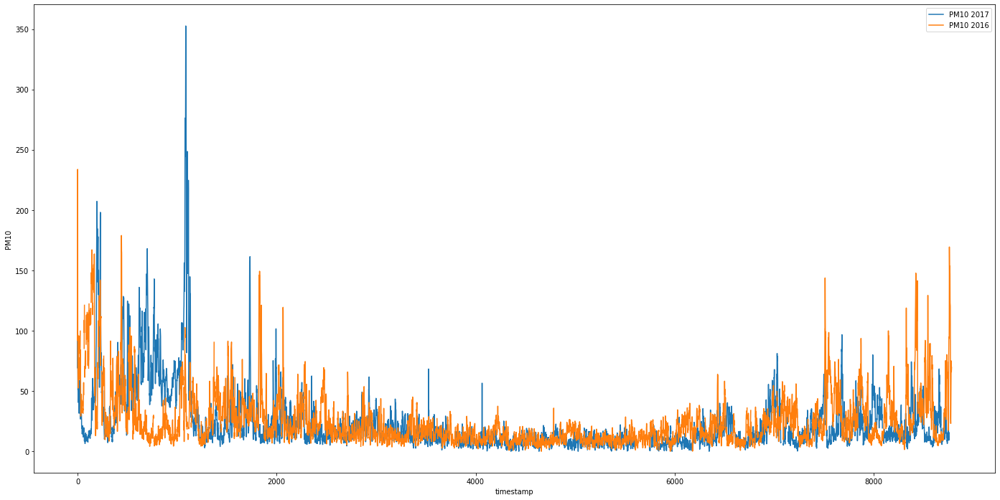

In [ ]:
#PM10 comparison between 2016 and 2017
fig,ax = plt.subplots(figsize = (24,12))

pm10_2016 = sns.lineplot(data_2017['timestamp'],data_2017['PM10'], label='PM10 2017')
pm10_2017 = sns.lineplot(data_2016['timestamp'],data_2016['PM10'], label='PM10 2016')

plt.show()

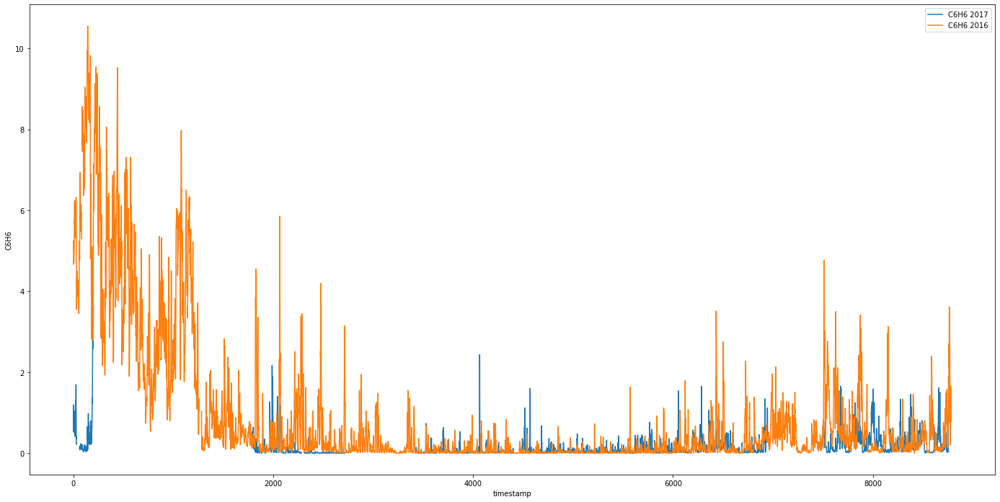

In [ ]:
#C6H6 comparison between 2016 and 2017
fig,ax = plt.subplots(figsize = (24,12))

pm10_2016 = sns.lineplot(data_2017['timestamp'],data_2017['C6H6'], label='C6H6 2017')
pm10_2017 = sns.lineplot(data_2016['timestamp'],data_2016['C6H6'], label='C6H6 2016')

plt.show()

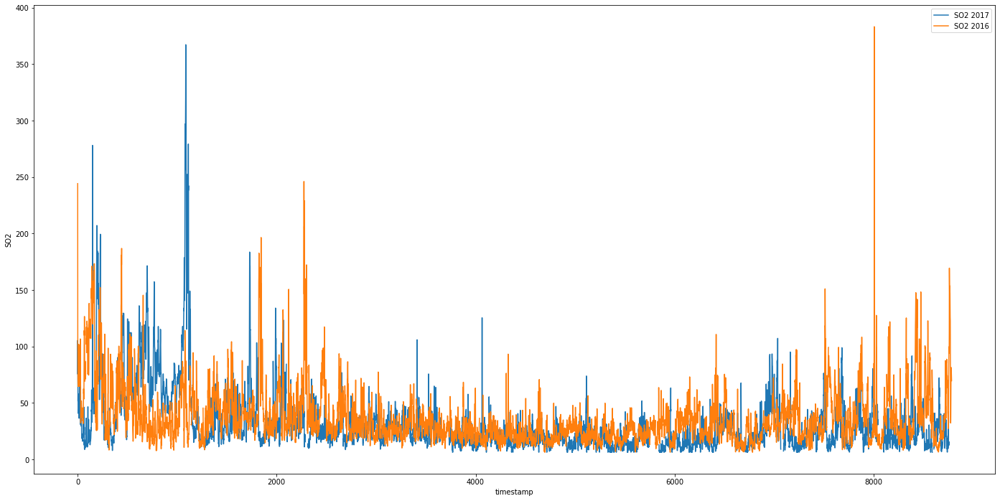

In [ ]:
#SO2 comparison between 2016 and 2017
fig,ax = plt.subplots(figsize = (24,12))

pm10_2016 = sns.lineplot(data_2017['timestamp'],data_2017['SO2'], label='SO2 2017')
pm10_2017 = sns.lineplot(data_2016['timestamp'],data_2016['SO2'], label='SO2 2016')

plt.show()

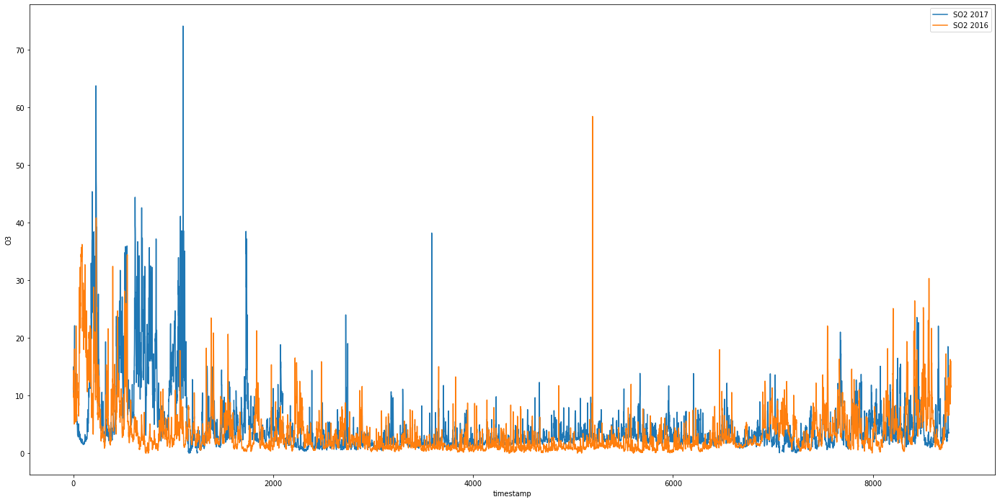

In [ ]:
#O3 comparison between 2016 and 2017
fig,ax = plt.subplots(figsize = (24,12))

pm10_2016 = sns.lineplot(data_2017['timestamp'],data_2017['O3'], label='O3 2017')
pm10_2017 = sns.lineplot(data_2016['timestamp'],data_2016['O3'], label='03 2016')

plt.show()

## Final correlation matrix

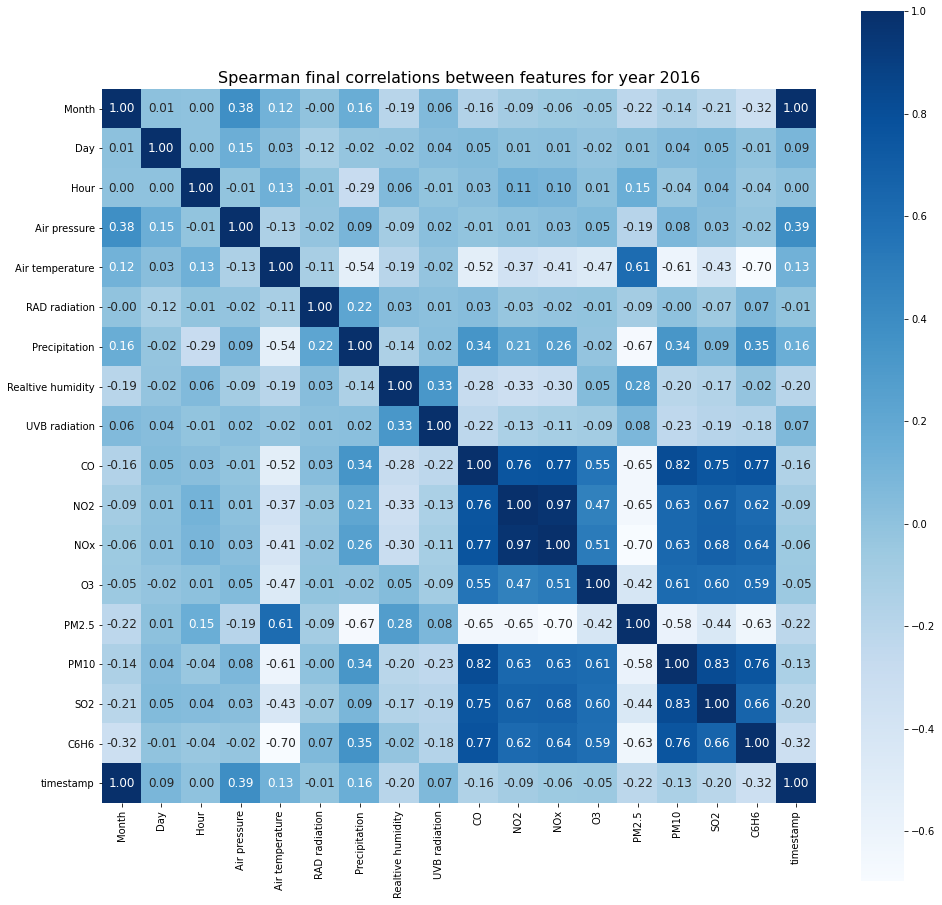

In [ ]:
plt.figure(figsize=(16,16))
corr_mat = data_2016.corr(method='spearman')
sns.heatmap(corr_mat, square=True, annot=True, fmt='.2f', annot_kws={'size':12}, cmap='Blues')
plt.title('Spearman final correlations between features for year 2016', fontsize = 16)

plt.show()

In [ ]:
#Saving data to csv. 
data_2016.to_csv('data_2016_final.csv')